Table of content:

[Description](#1)
1. [SmartScreen](#100)
    1. [SmartScreen / Census_OSInstallTypeName](#101)
    1. [SmartScreen / Platform](#102)
    1. [SmartScreen / OsVer](#103)
    1. [SmartScreen / Processor](#104)
    1. [SmartScreen / Census_OEMModelIdentifier](#105)
    1. [SmartScreen / Wdft_IsGamer](#106)
    1. [SmartScreen / Census_FirmwareVersionIdentifier](#107)
    1. [SmartScreen / CityIdentifier](#108)
    1. [SmartScreen / AVProductStatesIdentifier](#109)
    1. [SmartScreen / Census_ProcessorModelIdentifier](#110)
    1. [SmartScreen / AppVersion](#111)
    1. [SmartScreen / EngineVersion](#112)
    1. [SmartScreen / AVProductsInstalled](#113)
    1. [SmartScreen / LocaleEnglishNameIdentifier](#114)
    1. [SmartScreen / GeoNameIdentifier](#115)
    1. [SmartScreen / IsBeta](#116)
1. [AVProductStatesIdentifier](#200)
    1. [AVProductStatesIdentifier / AppVersion](#201)
    1. [AVProductStatesIdentifier / Wdft_IsGamer](#202)
    1. [AVProductStatesIdentifier / Census_OSInstallTypeName](#203)
    1. [AVProductStatesIdentifier / EngineVersion](#204)
    1. [AVProductStatesIdentifier / AVProductsInstalled](#205)
    1. [AVProductStatesIdentifier / Platform](#206)
    1. [AVProductStatesIdentifier / Processor](#207)
    1. [AVProductStatesIdentifier / OsVer](#208)
    1. [AVProductStatesIdentifier / Census_OEMModelIdentifier](#209)
    1. [AVProductStatesIdentifier / Census_FirmwareVersionIdentifier](#210)
    1. [AVProductStatesIdentifier / CityIdentifier](#211)
    1. [AVProductStatesIdentifier / Census_ProcessorModelIdentifier](#212)
    1. [AVProductStatesIdentifier / AppVersion](#213)
    1. [AVProductStatesIdentifier / LocaleEnglishNameIdentifier](#214)
    1. [AVProductStatesIdentifier / GeoNameIdentifier](#215)
    1. [AVProductStatesIdentifier / IsBeta](#216)
1. [AppVersion](#300)
    1. [AppVersion / Census_OSInstallTypeName](#301)
    1. [AppVersion / Platform](#302)
    1. [AppVersion / OsVer](#303)
    1. [AppVersion / Processor](#304)
    1. [AppVersion / Census_OEMModelIdentifier](#305)
    1. [AppVersion / Wdft_IsGamer](#306)
    1. [AppVersion / Census_FirmwareVersionIdentifier](#307)
    1. [AppVersion / CityIdentifier](#308)
    1. [AppVersion / AVProductStatesIdentifier](#309)
    1. [AppVersion / Census_ProcessorModelIdentifier](#310)
    1. [AppVersion / EngineVersion](#311)
    1. [AppVersion / AVProductsInstalled](#312)
    1. [AppVersion / LocaleEnglishNameIdentifier](#313)
    1. [AppVersion / GeoNameIdentifier](#314)
    1. [AppVersion / Census_InternalPrimaryDisplayResolutionHorizontal](#315)
    1. [AppVersion / Census_TotalPhysicalRAM](#316)
    1. [AppVersion / OsSuite](#317)
    1. [AppVersion / IsBeta](#318)
1. [EngineVersion](#400)
    1. [EngineVersion / Census_OSInstallTypeName](#401)
    1. [EngineVersion / Platform](#402)
    1. [EngineVersion / OsVer](#403)
    1. [EngineVersion / Processor](#404)
    1. [EngineVersion / Census_OEMModelIdentifier](#405)
    1. [EngineVersion / Wdft_IsGamer](#406)
    1. [EngineVersion / Census_FirmwareVersionIdentifier](#407)
    1. [EngineVersion / CityIdentifier](#408)
    1. [EngineVersion / AVProductStatesIdentifier](#409)
    1. [EngineVersion / Census_ProcessorModelIdentifier](#410)
    1. [EngineVersion / AVProductsInstalled](#411)
    1. [EngineVersion / LocaleEnglishNameIdentifier](#412)
    1. [EngineVersion / GeoNameIdentifier](#413)
    1. [EngineVersion / Census_InternalPrimaryDisplayResolutionHorizontal](#414)
    1. [EngineVersion / Census_TotalPhysicalRAM](#415)
    1. [EngineVersion / OsSuite](#416)

<a id="1"></a>
# Description
This kernel contains visual representation of 2nd level features interaction (interaction between 2 different features).

It seems like creating a new features out of available features interaction might be one of the keys to improve your model. So looking at the visualizations, presented here, one might make a decision on what features interactin might be useful and which doesn't worth spending time on.

### How to read visualizations:
<img src="http://i68.tinypic.com/qpf514.png" />

1. Name of the first feature out of our 2 features
1. Specific value of the first feature, which interaction with different values of the second feature we are looking at
1. The number of times when this specific value (2) is met in the first feature (1)
1. Percentage rate of the specific value (2) to all other values in the first feature
1. Scale. The same scale used to represent the detection rate and rate of the second feature values
1. Detection rate for the specifi value (2) of the first feature (1) to the specific value (7) of the second feature (8)
1. Specific value of the second feature
1. Name of the second feature

Every barplot is an interaction of a single different value out of feature number one.
So for example at the picture above we can see an interaction of values 'windows10' from 'Platform' feature to 10 most common values of 'SmartScreen' feature. Thus if Platform feature has a value of 'windows10' and 'SmartScreen' feature has a missing value (this is represented as NaN) then the detection rate in training data set is around 48% (0.48).

In [1]:
import warnings
warnings.simplefilter('ignore')
import pandas as pd
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
import gc
import multiprocessing
import time
from time import strftime
import seaborn as sns
import datetime
pd.set_option('display.max_columns', 83)
pd.set_option('display.max_rows', 83)
plt.style.use('seaborn')
for package in [pd, np, sns]:
    print(package.__name__, 'version:', package.__version__)
import os
print(os.listdir("../input"))

pandas version: 0.23.4
numpy version: 1.16.1
seaborn version: 0.9.0
['test.csv', 'train.csv', 'sample_submission.csv']


In [2]:
dtypes = {
        'MachineIdentifier':                                    'category',
        'ProductName':                                          'category',
        'EngineVersion':                                        'category',
        'AppVersion':                                           'category',
        'AvSigVersion':                                         'category',
        'IsBeta':                                               'int8',
        'RtpStateBitfield':                                     'float16',
        'IsSxsPassiveMode':                                     'int8',
        'DefaultBrowsersIdentifier':                            'float16',
        'AVProductStatesIdentifier':                            'float32',
        'AVProductsInstalled':                                  'float16',
        'AVProductsEnabled':                                    'float16',
        'HasTpm':                                               'int8',
        'CountryIdentifier':                                    'int16',
        'CityIdentifier':                                       'float32',
        'OrganizationIdentifier':                               'float16',
        'GeoNameIdentifier':                                    'float16',
        'LocaleEnglishNameIdentifier':                          'int8',
        'Platform':                                             'category',
        'Processor':                                            'category',
        'OsVer':                                                'category',
#         'OsBuild':                                              'int16',
        'OsSuite':                                              'int16',
#         'OsPlatformSubRelease':                                 'category',
        'OsBuildLab':                                           'category',
        'SkuEdition':                                           'category',
#         'IsProtected':                                          'float16',
        'AutoSampleOptIn':                                      'int8',
        'PuaMode':                                              'category',
        'SMode':                                                'float16',
        'IeVerIdentifier':                                      'float16',
        'SmartScreen':                                          'category',
        'Firewall':                                             'float16',
        'UacLuaenable':                                         'float32',
        'Census_MDC2FormFactor':                                'category',
        'Census_DeviceFamily':                                  'category',
        'Census_OEMNameIdentifier':                             'float16',
        'Census_OEMModelIdentifier':                            'float32',
        'Census_ProcessorCoreCount':                            'float16',
        'Census_ProcessorManufacturerIdentifier':               'float16',
        'Census_ProcessorModelIdentifier':                      'float16',
        'Census_ProcessorClass':                                'category',
        'Census_PrimaryDiskTotalCapacity':                      'float32',
        'Census_PrimaryDiskTypeName':                           'category',
        'Census_SystemVolumeTotalCapacity':                     'float32',
        'Census_HasOpticalDiskDrive':                           'int8',
        'Census_TotalPhysicalRAM':                              'float32',
        'Census_ChassisTypeName':                               'category',
        'Census_InternalPrimaryDiagonalDisplaySizeInInches':    'float16',
        'Census_InternalPrimaryDisplayResolutionHorizontal':    'float16',
        'Census_InternalPrimaryDisplayResolutionVertical':      'float16',
        'Census_PowerPlatformRoleName':                         'category',
        'Census_InternalBatteryType':                           'category',
        'Census_InternalBatteryNumberOfCharges':                'float32',
        'Census_OSVersion':                                     'category',
#         'Census_OSArchitecture':                                'category',
        'Census_OSBranch':                                      'category',
        'Census_OSBuildNumber':                                 'int16',
        'Census_OSBuildRevision':                               'int32',
        'Census_OSEdition':                                     'category',
#         'Census_OSSkuName':                                     'category',
        'Census_OSInstallTypeName':                             'category',
        'Census_OSInstallLanguageIdentifier':                   'float16',
#         'Census_OSUILocaleIdentifier':                          'int16',
        'Census_OSWUAutoUpdateOptionsName':                     'category',
        'Census_IsPortableOperatingSystem':                     'int8',
        'Census_GenuineStateName':                              'category',
        'Census_ActivationChannel':                             'category',
        'Census_IsFlightingInternal':                           'float16',
        'Census_IsFlightsDisabled':                             'float16',
        'Census_FlightRing':                                    'category',
        'Census_ThresholdOptIn':                                'float16',
        'Census_FirmwareManufacturerIdentifier':                'float16',
        'Census_FirmwareVersionIdentifier':                     'float32',
        'Census_IsSecureBootEnabled':                           'int8',
        'Census_IsWIMBootEnabled':                              'float16',
        'Census_IsVirtualDevice':                               'float16',
        'Census_IsTouchEnabled':                                'int8',
        'Census_IsPenCapable':                                  'int8',
        'Census_IsAlwaysOnAlwaysConnectedCapable':              'float16',
        'Wdft_IsGamer':                                         'float16',
        'Wdft_RegionIdentifier':                                'float16',
        'HasDetections':                                        'int8'
        }
def load_dataframe(dataset):
    usecols = dtypes.keys()
    if dataset == 'test':
        usecols = [col for col in dtypes.keys() if col != 'HasDetections']
    df = pd.read_csv(f'../input/{dataset}.csv', dtype=dtypes, usecols=usecols)
    return df
with multiprocessing.Pool() as pool:
    train, test = pool.map(load_dataframe, ["train", "test"])

In [3]:
def plot_features_interaction_binary(df, first_feature, second_feature, first_feature_values, second_feature_values, target):
    """
    This function plots two features interaction along with target value for a binary classification task
    Args:
        df (pandas.DataFrame): dataset
        first_feature (str): name of the first feature
        second_feature (str): name of the second feature
        first_feature_values (int): number of values out of the first feature to plot
        second_feature_values (int): number of values out of the second feature to plot
        target (str): name of the target feature
    """
    # If first_feature_values argument is not set we are using all possible values of the first_feature
    if not first_feature_values:
        first_feature_values = df[first_feature].value_counts(dropna=False).shape[0]
    # If second_feature_values argument is not set we are using all possible values of the second_feature
    if not second_feature_values:
        second_feature_values = df[second_feature].value_counts(dropna=False).shape[0]
    # If first_feature_values argument exceeds the number of different features in first_feature we are resetting it
    first_feature_values = min(first_feature_values, df[first_feature].value_counts(dropna=False).shape[0])
    # If second_feature_values argument exceeds the number of different features in second_feature we are resetting it
    second_feature_values = min(second_feature_values, df[second_feature].value_counts(dropna=False).shape[0])
    
    # One barplot per row
    # Number of rows equals to a number of features for the first_feature
    fig, axes = plt.subplots(nrows=first_feature_values, ncols=1, figsize=(14, first_feature_values * 6))
    fig.subplots_adjust(hspace=1)
        
    for i in range(first_feature_values):
        # Handling NaN values
        if pd.isna(train[first_feature].value_counts(dropna=False).index[i]):
            features_interaction_df = df.loc[df[first_feature].isnull(), second_feature].value_counts(True, dropna=False).head(second_feature_values)
        else:
            features_interaction_df = df.loc[df[first_feature] == df[first_feature].value_counts(dropna=False).index[i], second_feature].value_counts(True, dropna=False).head(second_feature_values)
        features_interaction_df.plot(kind='bar', ax=axes[i], fontsize=14, rot=45).set_xlabel(second_feature, fontsize=14);
        for j in range(min(second_feature_values, features_interaction_df.shape[0])):
            try:
                # Again handling NaN values this time for both features
                # I'm pretty sure it might be done in more elegant way
                if pd.isna(train[first_feature].value_counts(dropna=False).index[i]) and not pd.isna(features_interaction_df.index[j]):
                    detection_rate = df.loc[(df[first_feature].isnull()) & (df[second_feature] == features_interaction_df.index[j]), target].value_counts(True)[1]
                elif not pd.isna(train[first_feature].value_counts(dropna=False).index[i]) and pd.isna(features_interaction_df.index[j]):
                    detection_rate = df.loc[(df[first_feature] == df[first_feature].value_counts(dropna=False).index[i]) & (df[second_feature].isnull()), target].value_counts(True)[1]
                elif pd.isna(train[first_feature].value_counts(dropna=False).index[i]) and pd.isna(features_interaction_df.index[j]):
                    detection_rate = df.loc[(df[first_feature].isnull()) & (df[second_feature].isnull()), target].value_counts(True)[1]
                else:
                    detection_rate = df.loc[(df[first_feature] == df[first_feature].value_counts(dropna=False).index[i]) & (df[second_feature] == features_interaction_df.index[j]), target].value_counts(True)[1]
            except:
                detection_rate = 0
            axes[i].plot(j, detection_rate, marker='.', color="black", markersize=22)
            axes[i].text(j + 0.1, y=detection_rate, s="%.2f" % detection_rate, fontsize=16, fontweight='bold')
        axes[i].set_title(first_feature + ': ' + str(df[first_feature].value_counts(dropna=False).index[i]) + ' - {0} values ({1:.2f}% of total)'.format(df[first_feature].value_counts(dropna=False).values[i], (df[first_feature].value_counts(dropna=False).values[i] / train[first_feature].value_counts(dropna=False).values.sum()) * 100), fontsize=18);

<a id="100"></a>
# SmartScreen
<a id="101"></a>
## SmartScreen / Census_OSInstallTypeName

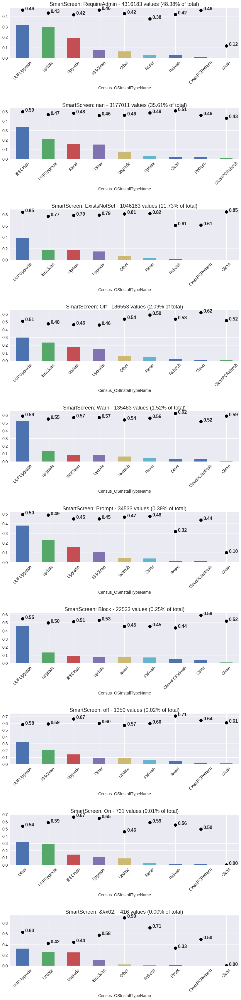

In [4]:
plot_features_interaction_binary(train, 'SmartScreen', 'Census_OSInstallTypeName', 10, 10, 'HasDetections')

<a id="102"></a>
## SmartScreen / Platform

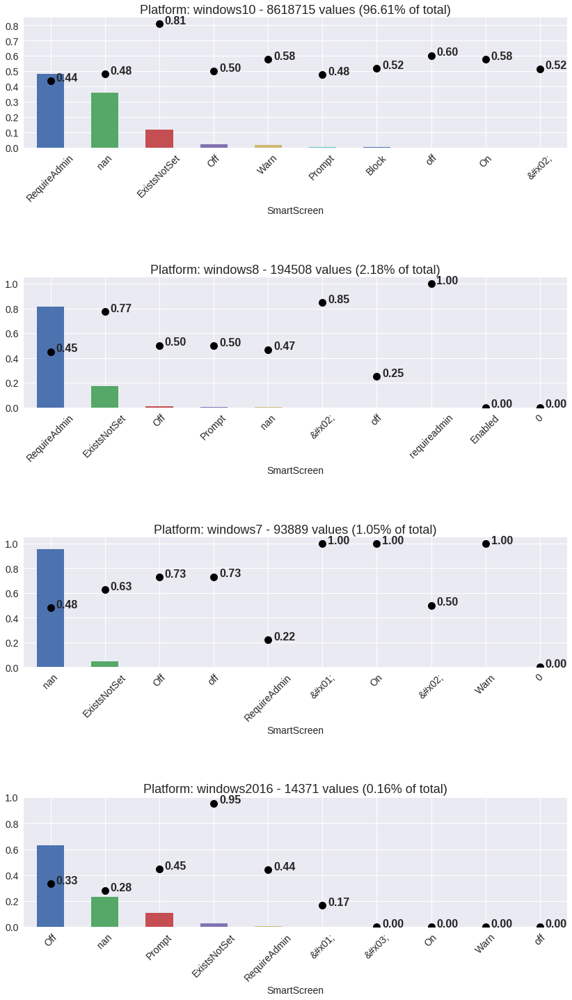

In [5]:
plot_features_interaction_binary(train, 'Platform', 'SmartScreen', 10, 10, 'HasDetections')

<a id="103"></a>
## SmartScreen / OsVer

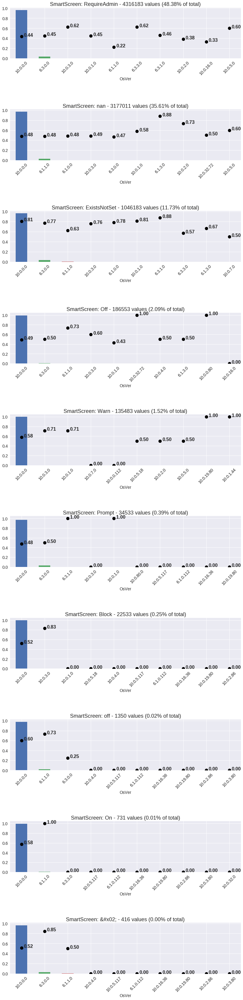

In [6]:
plot_features_interaction_binary(train, 'SmartScreen', 'OsVer', 10, 10, 'HasDetections')

<a id="104"></a>
## SmartScreen / Processor

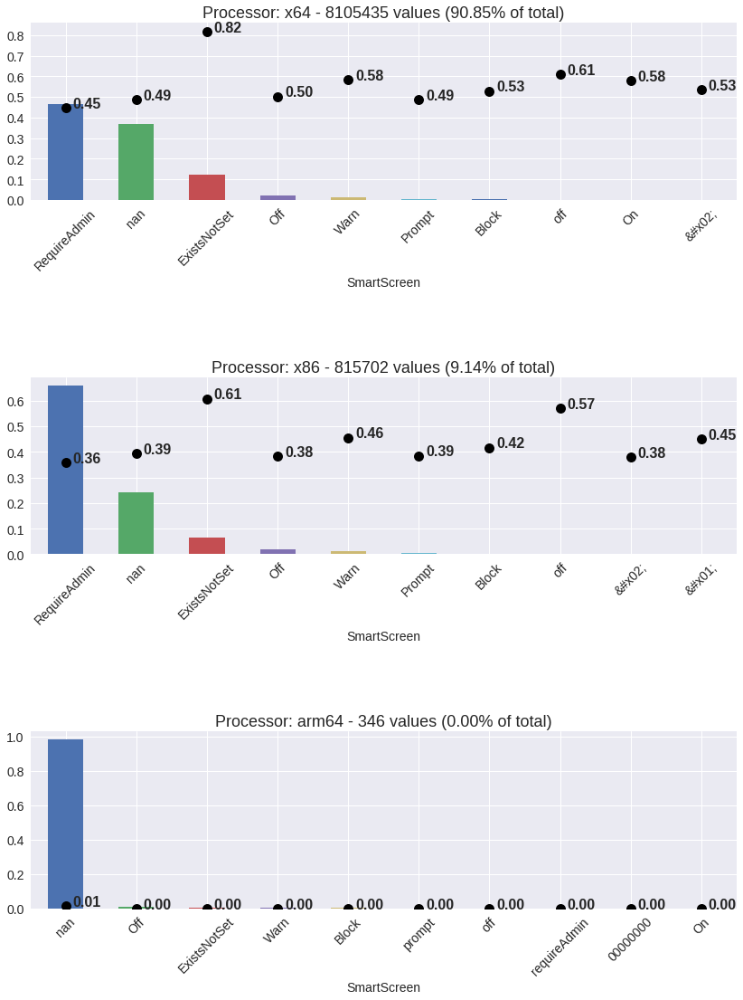

In [7]:
plot_features_interaction_binary(train, 'Processor', 'SmartScreen', 10, 10, 'HasDetections')

<a id="105"></a>
## SmartScreen / Census_OEMModelIdentifier

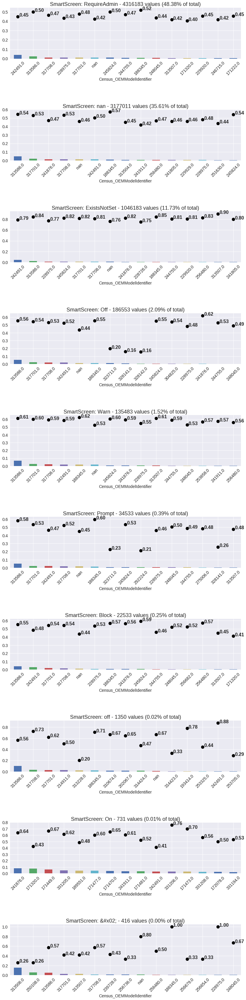

In [8]:
plot_features_interaction_binary(train, 'SmartScreen', 'Census_OEMModelIdentifier', 10, 15, 'HasDetections')

<a id="106"></a>
## SmartScreen / Wdft_IsGamer

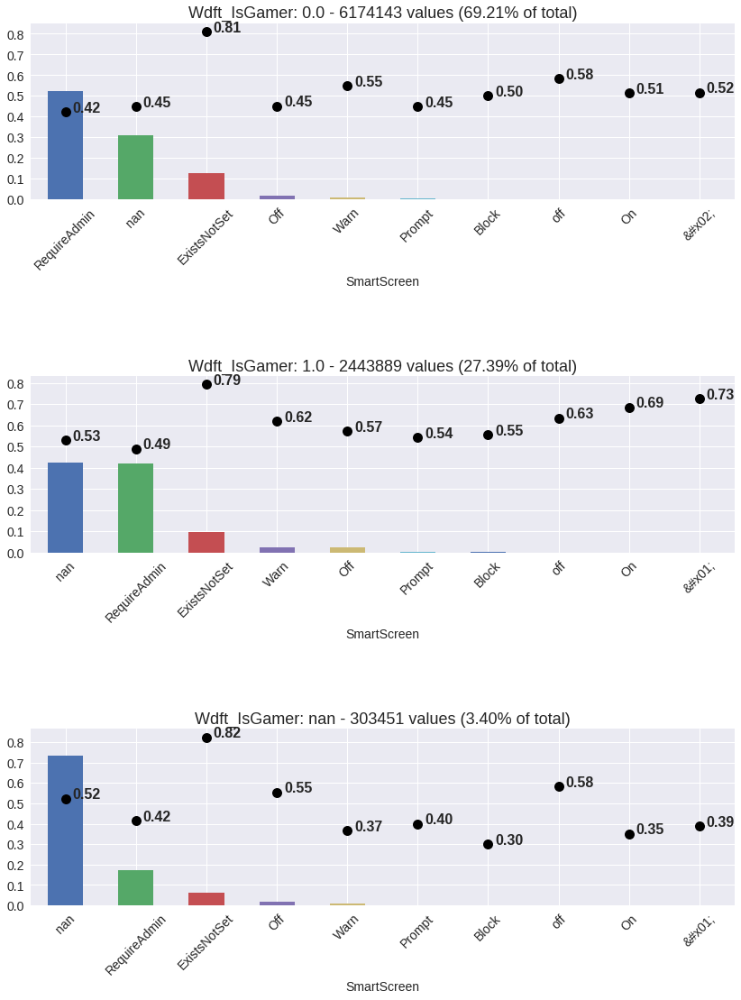

In [9]:
plot_features_interaction_binary(train, 'Wdft_IsGamer', 'SmartScreen', 10, 10, 'HasDetections')

<a id="107"></a>
## SmartScreen / Census_FirmwareVersionIdentifier

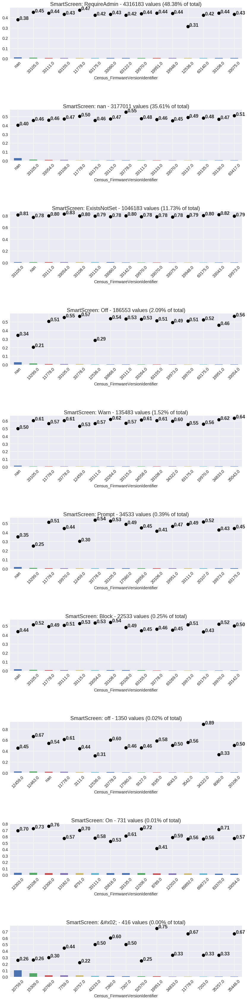

In [10]:
plot_features_interaction_binary(train, 'SmartScreen', 'Census_FirmwareVersionIdentifier', 10, 15, 'HasDetections')

<a id="108"></a>
## SmartScreen / CityIdentifier

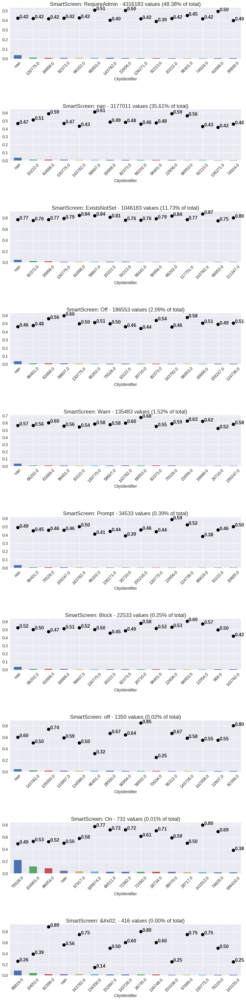

In [11]:
plot_features_interaction_binary(train, 'SmartScreen', 'CityIdentifier', 10, 15, 'HasDetections')

<a id="109"></a>
## SmartScreen / AVProductStatesIdentifier

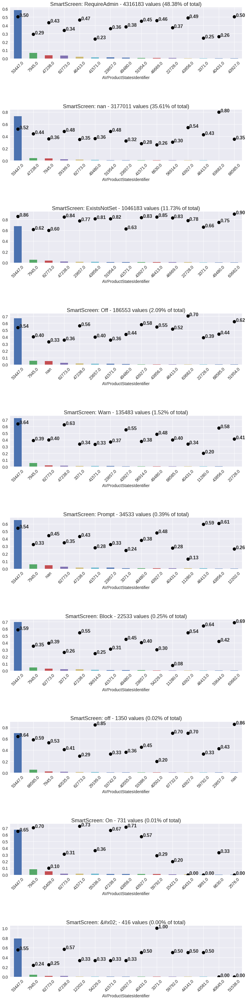

In [12]:
plot_features_interaction_binary(train, 'SmartScreen', 'AVProductStatesIdentifier', 10, 15, 'HasDetections')

<a id="110"></a>
## SmartScreen / Census_ProcessorModelIdentifier

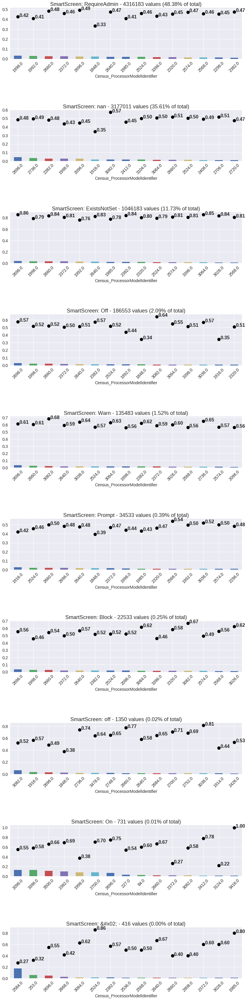

In [13]:
plot_features_interaction_binary(train, 'SmartScreen', 'Census_ProcessorModelIdentifier', 10, 15, 'HasDetections')

<a id="111"></a>
## SmartScreen / AppVersion

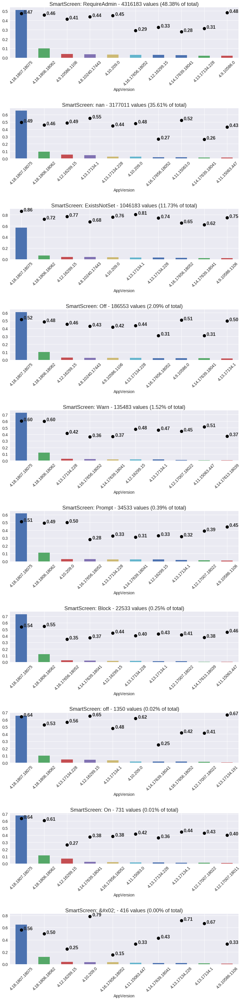

In [14]:
plot_features_interaction_binary(train, 'SmartScreen', 'AppVersion', 10, 10, 'HasDetections')

<a id="112"></a>
## SmartScreen / EngineVersion

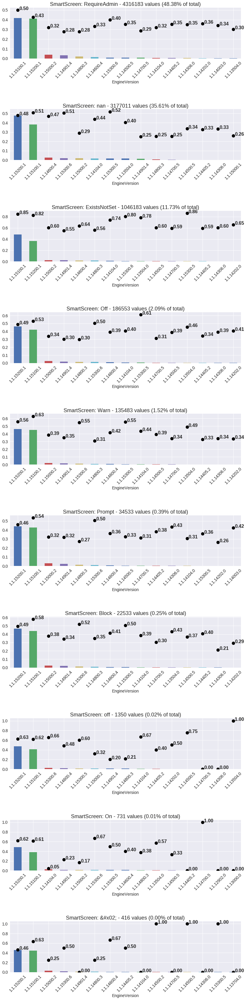

In [15]:
plot_features_interaction_binary(train, 'SmartScreen', 'EngineVersion', 10, 15, 'HasDetections')

<a id="113"></a>
## SmartScreen / AVProductsInstalled

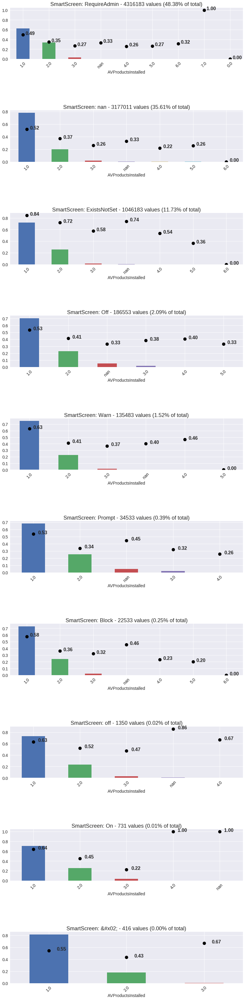

In [16]:
plot_features_interaction_binary(train, 'SmartScreen', 'AVProductsInstalled', 10, 10, 'HasDetections')

<a id="114"></a>
## SmartScreen / LocaleEnglishNameIdentifier

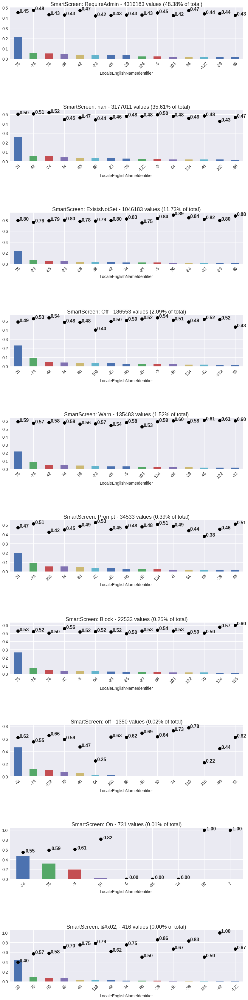

In [17]:
plot_features_interaction_binary(train, 'SmartScreen', 'LocaleEnglishNameIdentifier', 10, 15, 'HasDetections')

<a id="115"></a>
## SmartScreen / GeoNameIdentifier

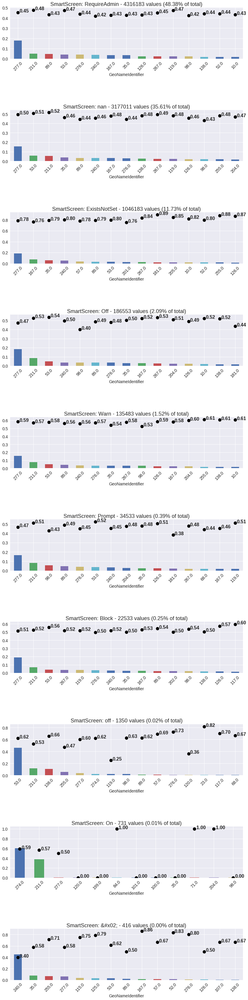

In [18]:
plot_features_interaction_binary(train, 'SmartScreen', 'GeoNameIdentifier', 10, 15, 'HasDetections')

<a id="116"></a>
## SmartScreen / IsBeta

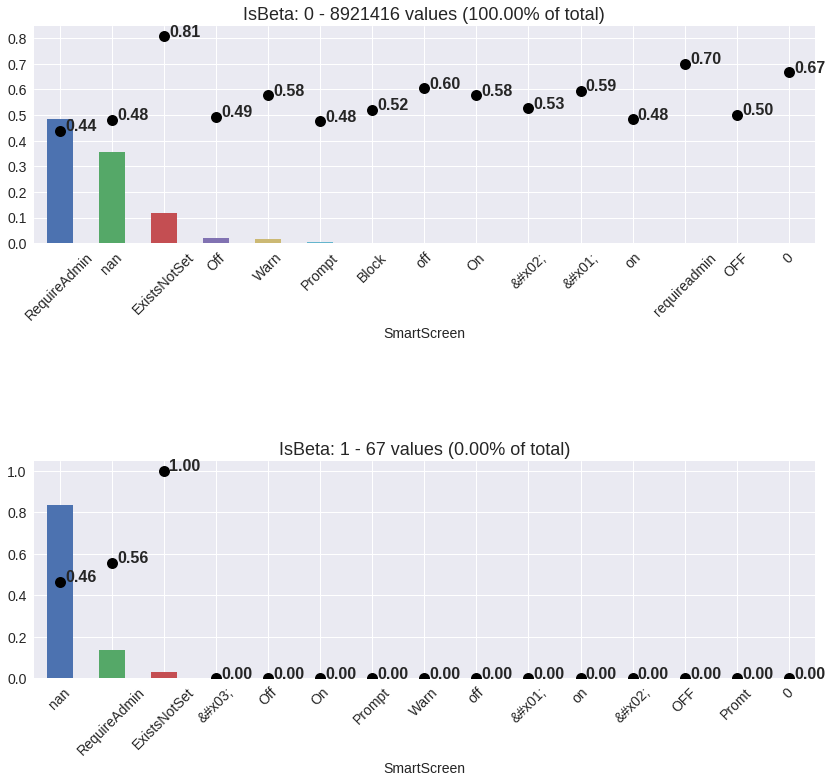

In [19]:
plot_features_interaction_binary(train, 'IsBeta', 'SmartScreen', 10, 15, 'HasDetections')

<a id="200"></a>
# AVProductStatesIdentifier
<a id="201"></a>
## AVProductStatesIdentifier / AppVersion

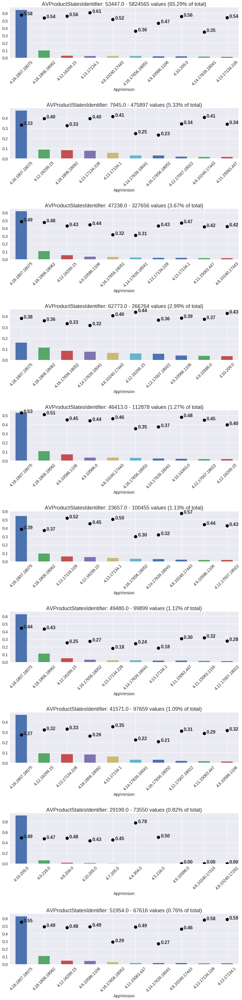

In [20]:
plot_features_interaction_binary(train, 'AVProductStatesIdentifier', 'AppVersion', 10, 10, 'HasDetections')

<a id="202"></a>
## AVProductStatesIdentifier / Wdft_IsGamer

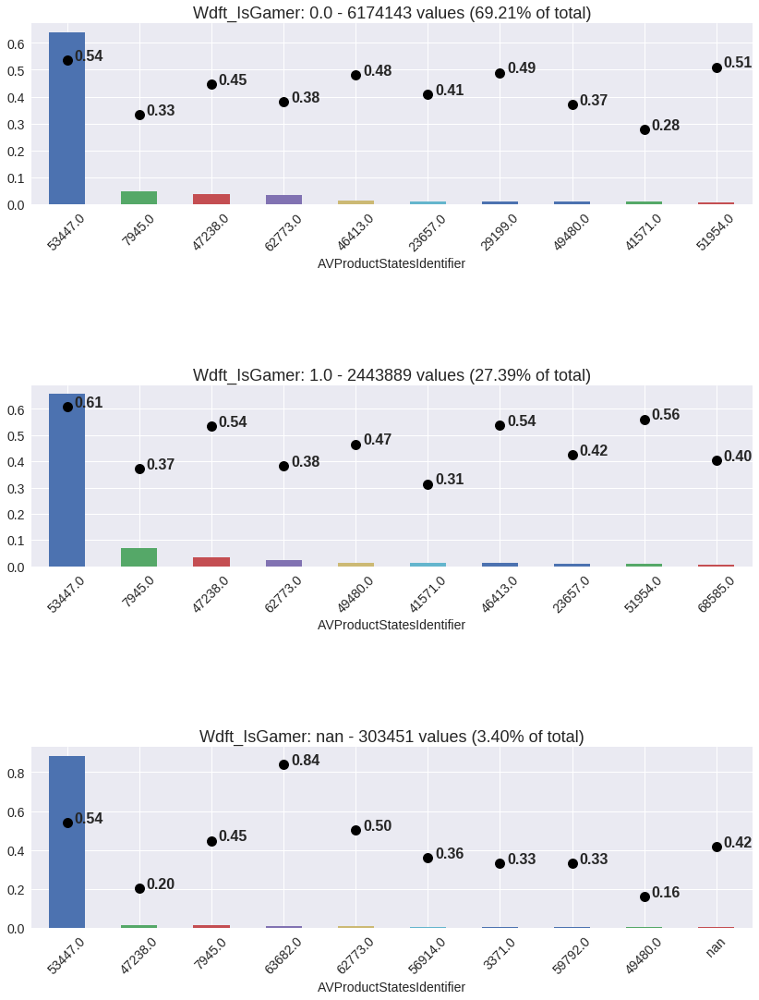

In [21]:
plot_features_interaction_binary(train, 'Wdft_IsGamer', 'AVProductStatesIdentifier', 10, 10, 'HasDetections')

<a id="203"></a>
## AVProductStatesIdentifier / Census_OSInstallTypeName

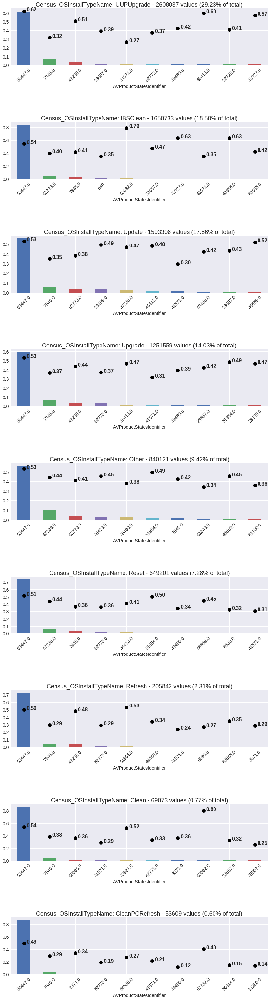

In [22]:
plot_features_interaction_binary(train, 'Census_OSInstallTypeName', 'AVProductStatesIdentifier', 10, 10, 'HasDetections')

<a id="204"></a>
## AVProductStatesIdentifier / EngineVersion

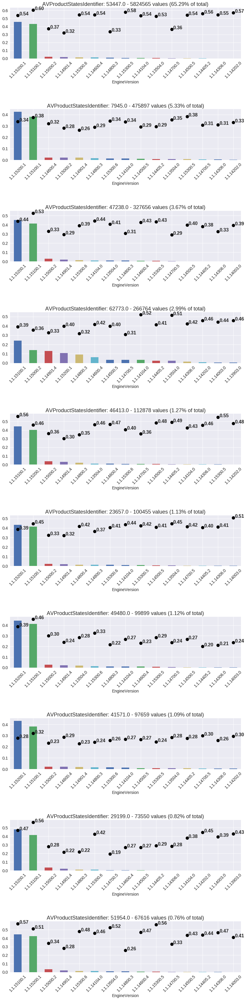

In [23]:
plot_features_interaction_binary(train, 'AVProductStatesIdentifier', 'EngineVersion', 10, 15, 'HasDetections')

<a id="205"></a>
## AVProductStatesIdentifier / AVProductsInstalled

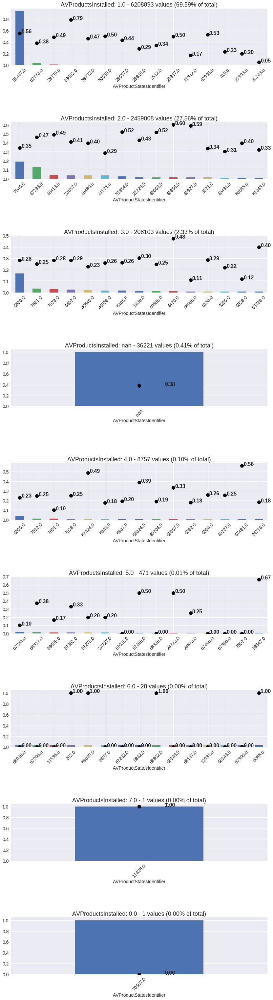

In [24]:
plot_features_interaction_binary(train, 'AVProductsInstalled', 'AVProductStatesIdentifier', 10, 15, 'HasDetections')

<a id="206"></a>
## AVProductStatesIdentifier / Platform

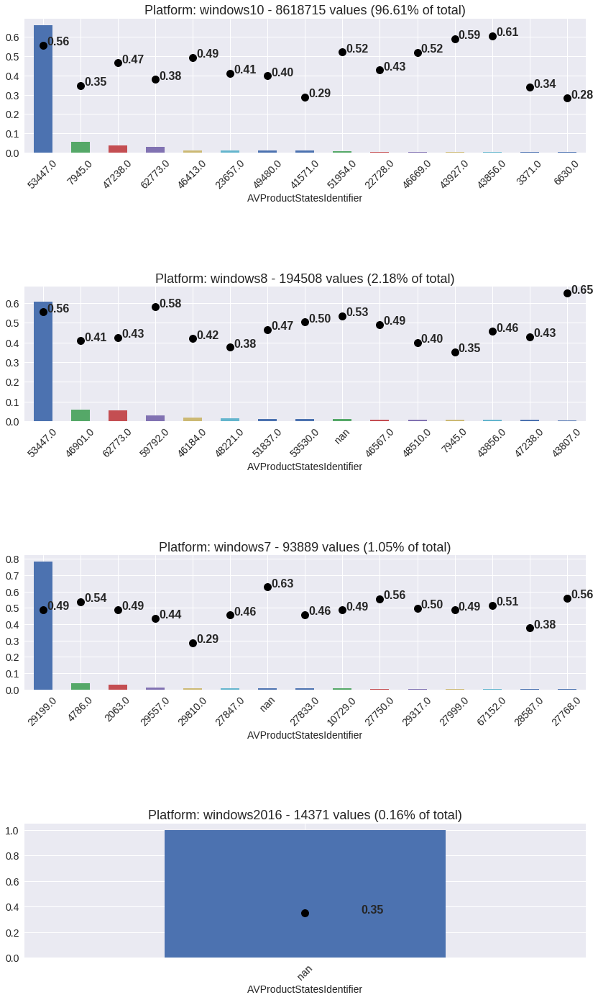

In [25]:
plot_features_interaction_binary(train, 'Platform', 'AVProductStatesIdentifier', 10, 15, 'HasDetections')

<a id="207"></a>
## AVProductStatesIdentifier / Processor

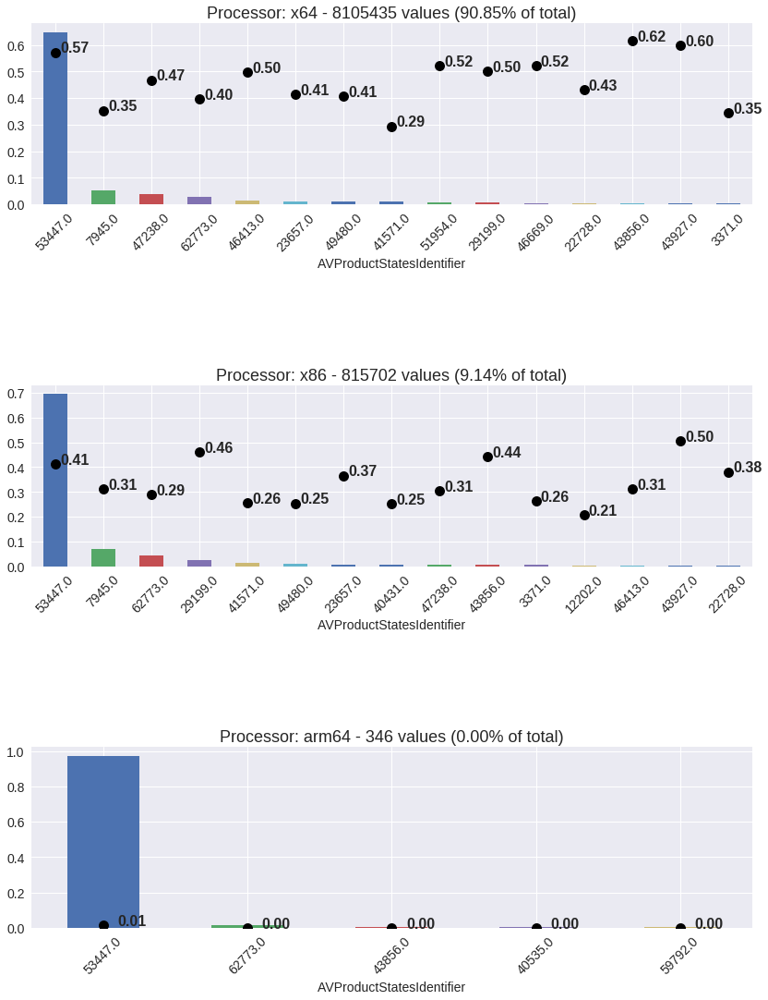

In [26]:
plot_features_interaction_binary(train, 'Processor', 'AVProductStatesIdentifier', 10, 15, 'HasDetections')

<a id="208"></a>
## AVProductStatesIdentifier / OsVer

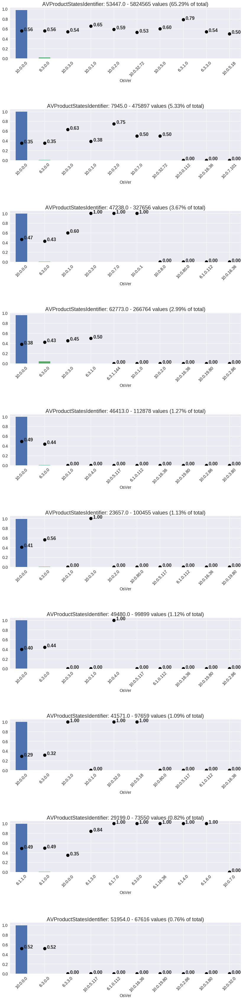

In [27]:
plot_features_interaction_binary(train, 'AVProductStatesIdentifier', 'OsVer', 10, 10, 'HasDetections')

<a id="209"></a>
## AVProductStatesIdentifier / Census_OEMModelIdentifier

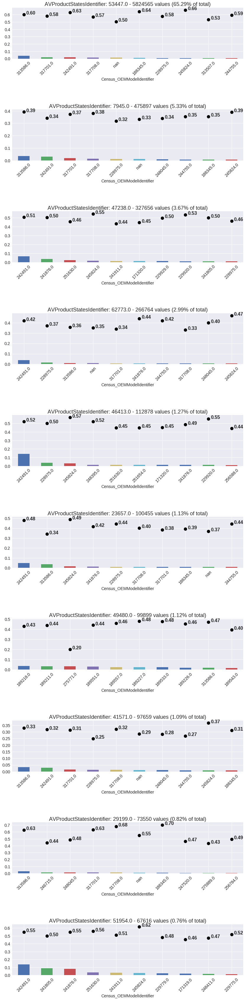

In [28]:
plot_features_interaction_binary(train, 'AVProductStatesIdentifier', 'Census_OEMModelIdentifier', 10, 10, 'HasDetections')

<a id="210"></a>
## AVProductStatesIdentifier / Census_FirmwareVersionIdentifier

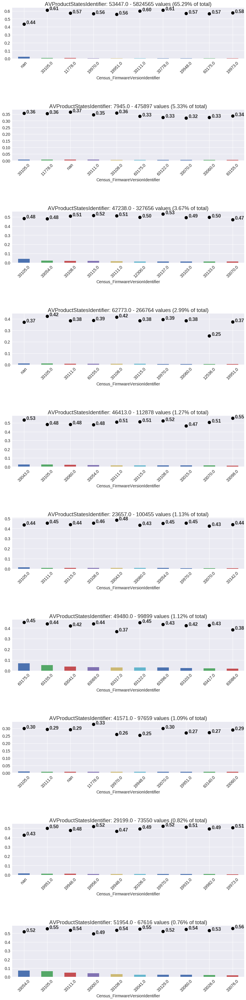

In [29]:
plot_features_interaction_binary(train, 'AVProductStatesIdentifier', 'Census_FirmwareVersionIdentifier', 10, 10, 'HasDetections')

<a id="211"></a>
## AVProductStatesIdentifier / CityIdentifier

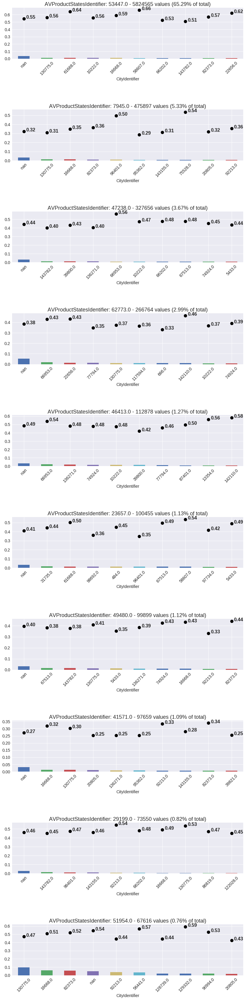

In [30]:
plot_features_interaction_binary(train, 'AVProductStatesIdentifier', 'CityIdentifier', 10, 10, 'HasDetections')

<a id="212"></a>
## AVProductStatesIdentifier / Census_ProcessorModelIdentifier

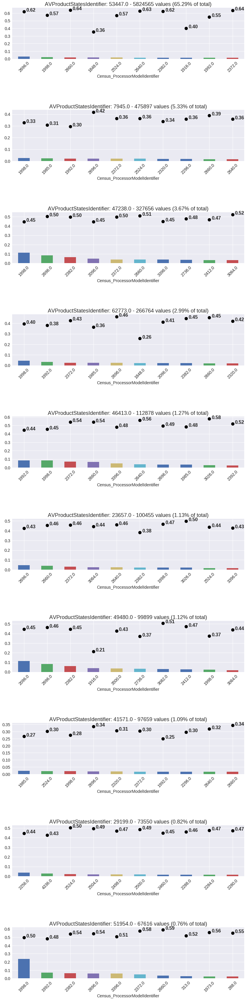

In [31]:
plot_features_interaction_binary(train, 'AVProductStatesIdentifier', 'Census_ProcessorModelIdentifier', 10, 10, 'HasDetections')

<a id="213"></a>
## AVProductStatesIdentifier / AppVersion

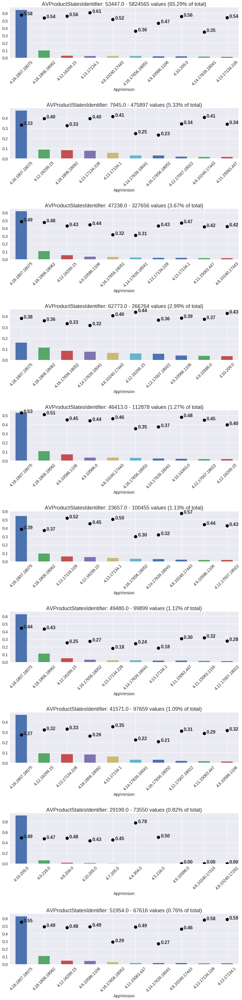

In [32]:
plot_features_interaction_binary(train, 'AVProductStatesIdentifier', 'AppVersion', 10, 10, 'HasDetections')

<a id="214"></a>
## AVProductStatesIdentifier / LocaleEnglishNameIdentifier

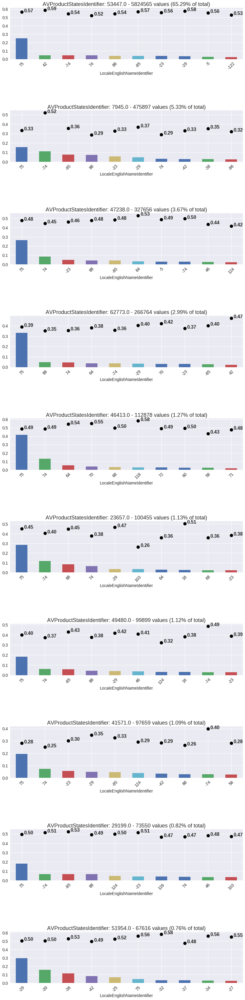

In [33]:
plot_features_interaction_binary(train, 'AVProductStatesIdentifier', 'LocaleEnglishNameIdentifier', 10, 10, 'HasDetections')

<a id="215"></a>
## AVProductStatesIdentifier / GeoNameIdentifier

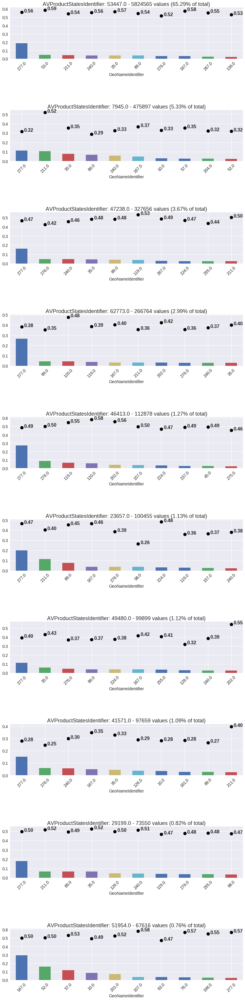

In [34]:
plot_features_interaction_binary(train, 'AVProductStatesIdentifier', 'GeoNameIdentifier', 10, 10, 'HasDetections')

<a id="216"></a>
## AVProductStatesIdentifier / IsBeta

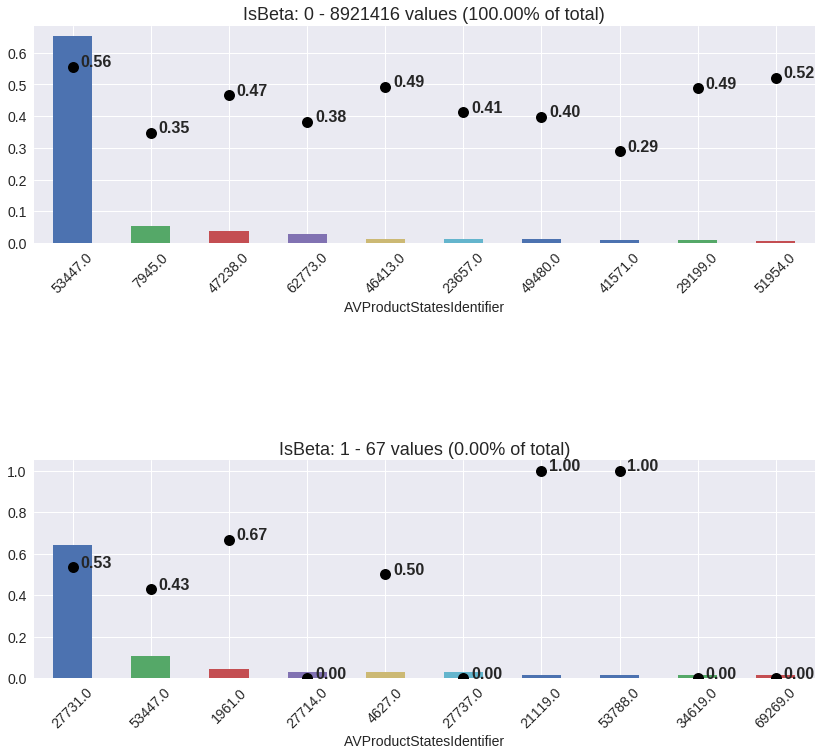

In [35]:
plot_features_interaction_binary(train, 'IsBeta', 'AVProductStatesIdentifier', 10, 10, 'HasDetections')

<a id="300"></a>
# AppVersion
<a id="301"></a>
## AppVersion / Census_OSInstallTypeName

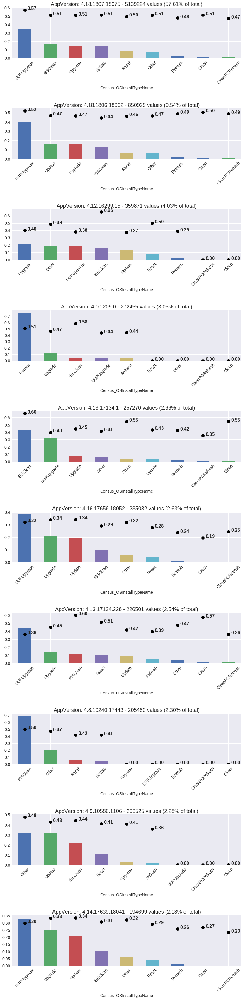

In [36]:
plot_features_interaction_binary(train, 'AppVersion', 'Census_OSInstallTypeName', 10, 10, 'HasDetections')

<a id="302"></a>
## AppVersion / Platform

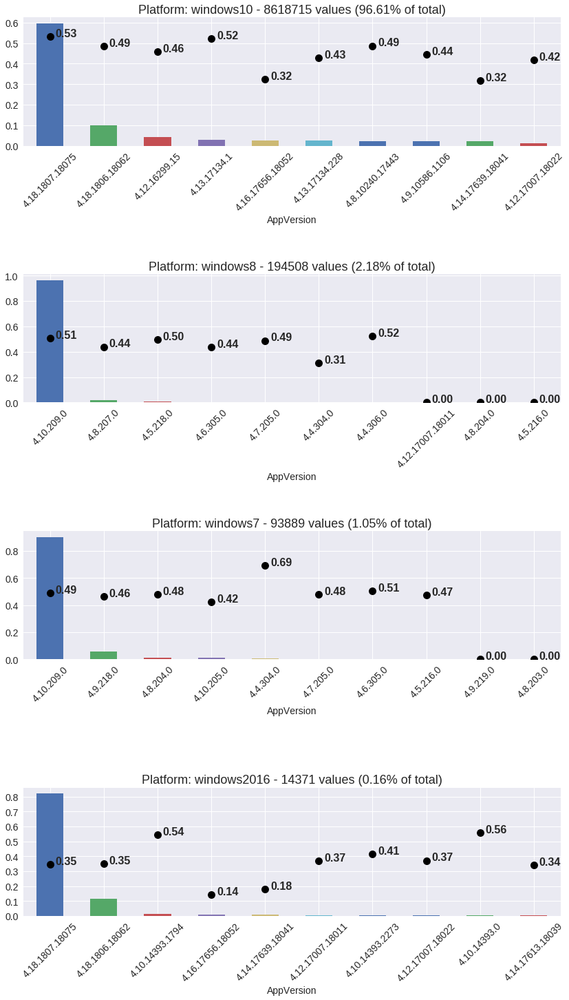

In [37]:
plot_features_interaction_binary(train, 'Platform', 'AppVersion',10, 10, 'HasDetections')

<a id="303"></a>
## AppVersion / OsVer

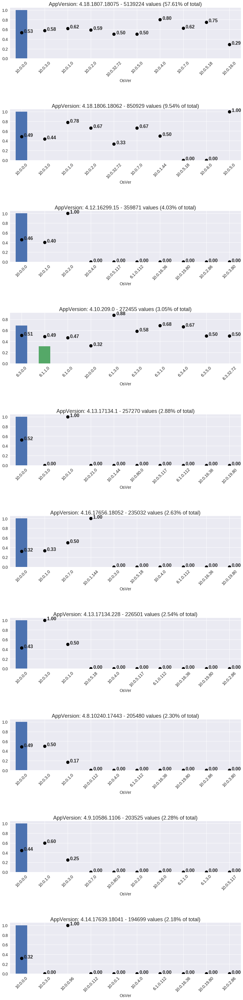

In [38]:
plot_features_interaction_binary(train, 'AppVersion', 'OsVer', 10, 10, 'HasDetections')

<a id="304"></a>
## AppVersion / Processor

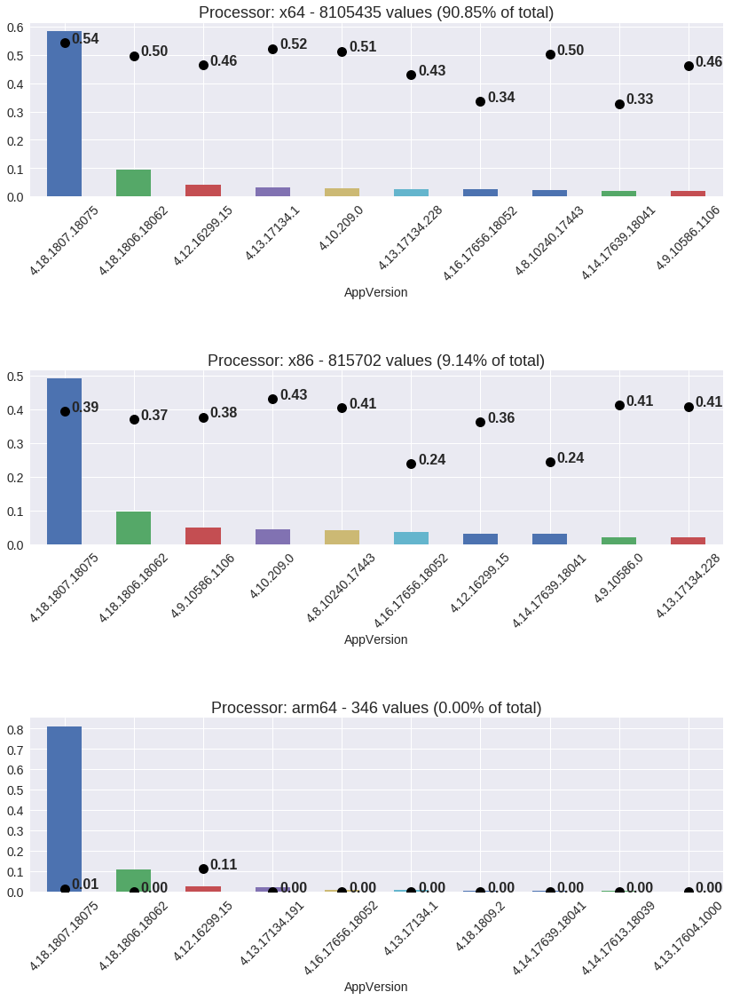

In [39]:
plot_features_interaction_binary(train, 'Processor', 'AppVersion', 10, 10, 'HasDetections')

<a id="305"></a>
## AppVersion / Census_OEMModelIdentifier

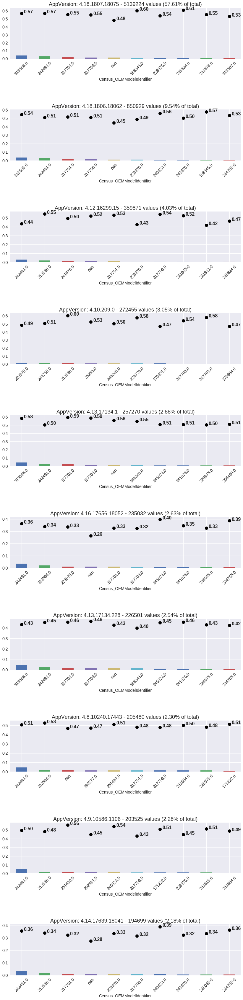

In [40]:
plot_features_interaction_binary(train, 'AppVersion', 'Census_OEMModelIdentifier', 10, 10, 'HasDetections')

<a id="306"></a>
## AppVersion / Wdft_IsGamer

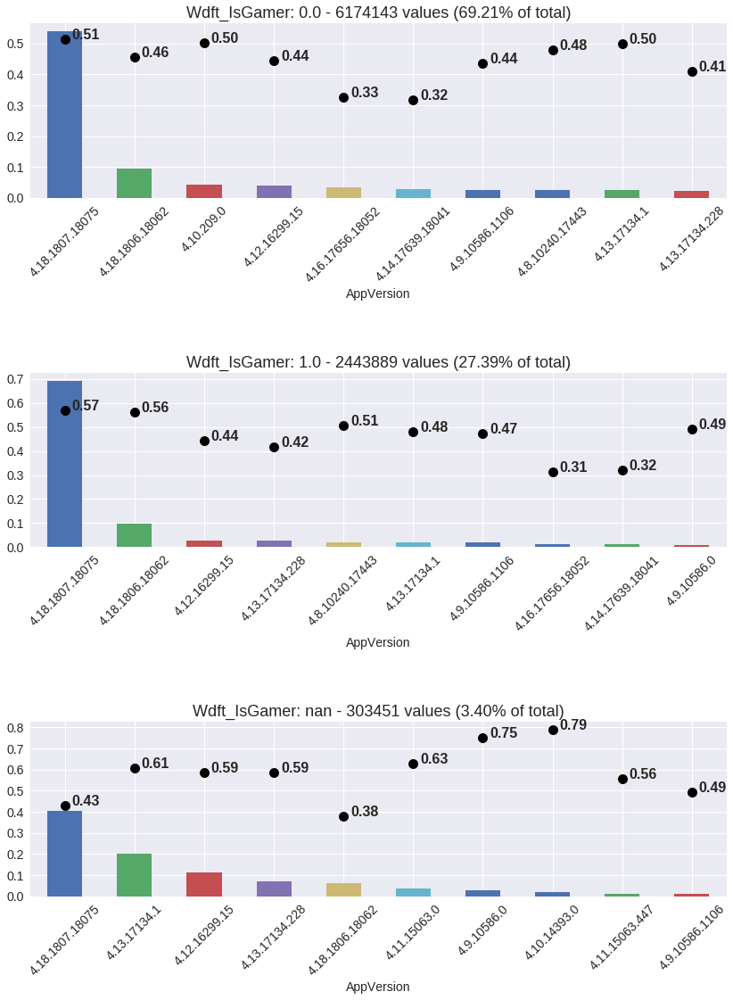

In [41]:
plot_features_interaction_binary(train, 'Wdft_IsGamer', 'AppVersion', 10, 10, 'HasDetections')

<a id="307"></a>
## AppVersion / Census_FirmwareVersionIdentifier

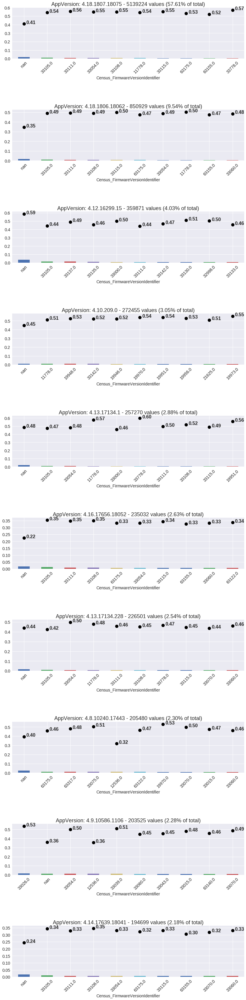

In [42]:
plot_features_interaction_binary(train, 'AppVersion', 'Census_FirmwareVersionIdentifier', 10, 10, 'HasDetections')

<a id="308"></a>
## AppVersion / CityIdentifier

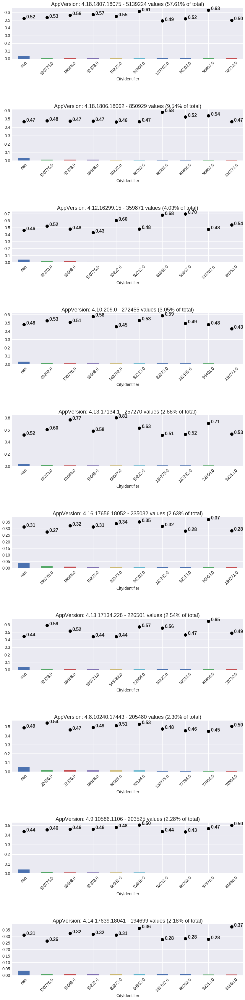

In [43]:
plot_features_interaction_binary(train, 'AppVersion', 'CityIdentifier', 10, 10, 'HasDetections')

<a id="309"></a>
## AppVersion / AVProductStatesIdentifier

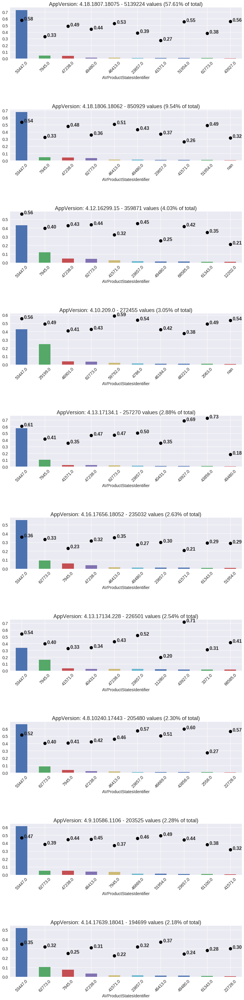

In [44]:
plot_features_interaction_binary(train, 'AppVersion', 'AVProductStatesIdentifier', 10, 10, 'HasDetections')

<a id="310"></a>
## AppVersion / Census_ProcessorModelIdentifier

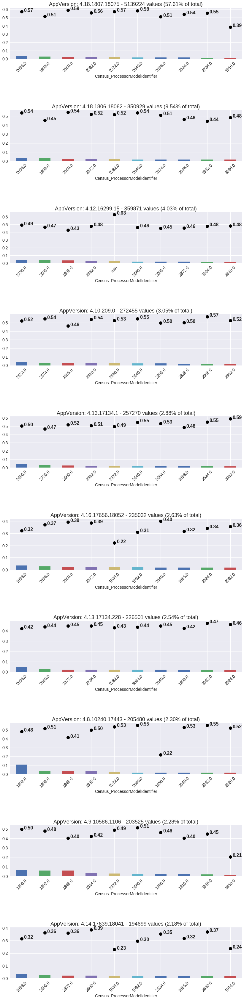

In [45]:
plot_features_interaction_binary(train, 'AppVersion', 'Census_ProcessorModelIdentifier', 10, 10, 'HasDetections')

<a id="311"></a>
## AppVersion / EngineVersion

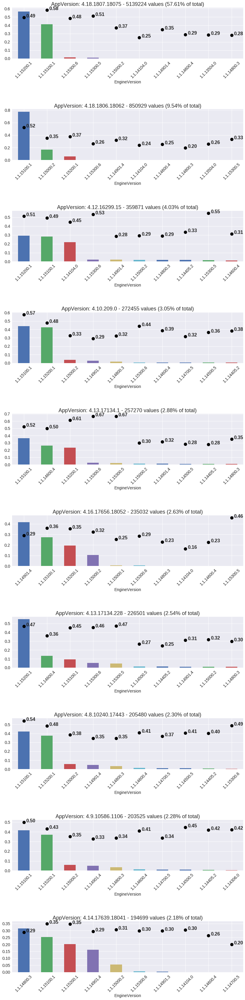

In [46]:
plot_features_interaction_binary(train, 'AppVersion', 'EngineVersion', 10, 10, 'HasDetections')

<a id="312"></a>
## AppVersion / AVProductsInstalled

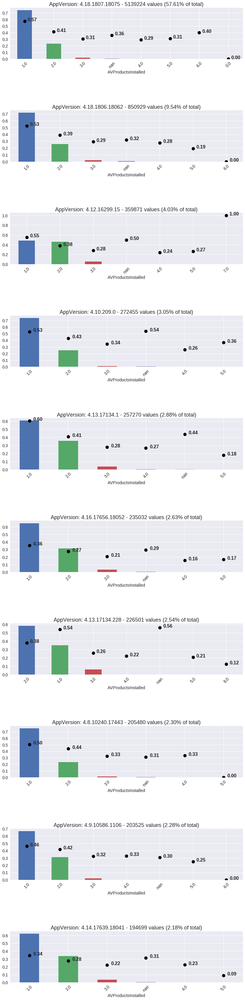

In [47]:
plot_features_interaction_binary(train, 'AppVersion', 'AVProductsInstalled', 10, 10, 'HasDetections')

<a id="313"></a>
## AppVersion / LocaleEnglishNameIdentifier

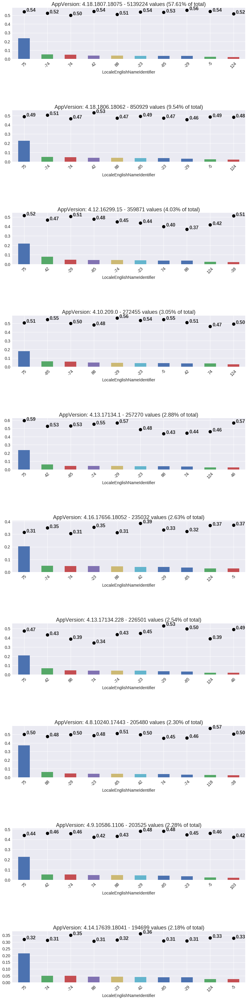

In [48]:
plot_features_interaction_binary(train, 'AppVersion', 'LocaleEnglishNameIdentifier', 10, 10, 'HasDetections')

<a id="314"></a>
## AppVersion / GeoNameIdentifier

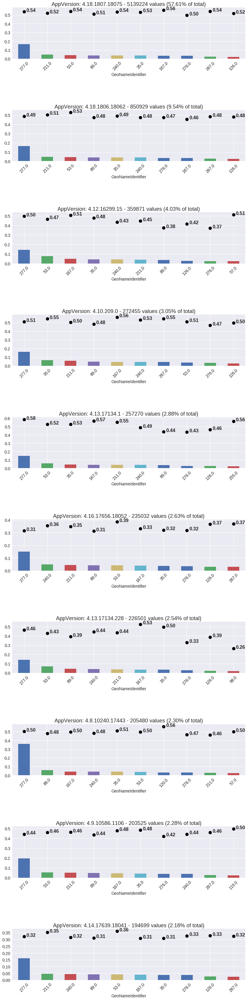

In [49]:
plot_features_interaction_binary(train, 'AppVersion', 'GeoNameIdentifier', 10, 10, 'HasDetections')

<a id="315"></a>
## AppVersion / Census_InternalPrimaryDisplayResolutionHorizontal

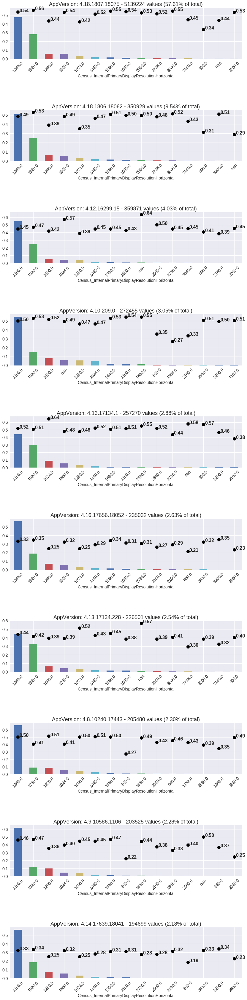

In [50]:
plot_features_interaction_binary(train, 'AppVersion', 'Census_InternalPrimaryDisplayResolutionHorizontal', 10, 15, 'HasDetections')

<a id="316"></a>
## AppVersion / Census_TotalPhysicalRAM

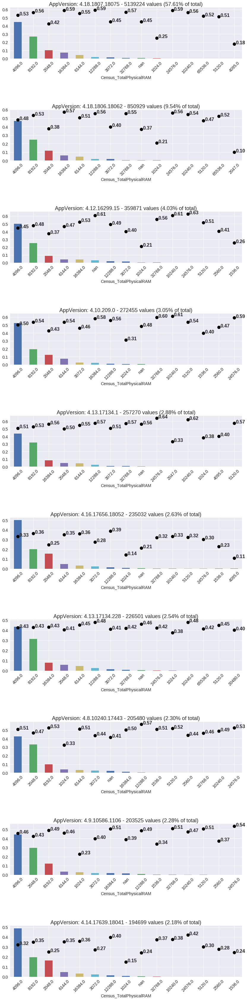

In [51]:
plot_features_interaction_binary(train, 'AppVersion', 'Census_TotalPhysicalRAM', 10, 15, 'HasDetections')

<a id="317"></a>
## AppVersion / OsSuite

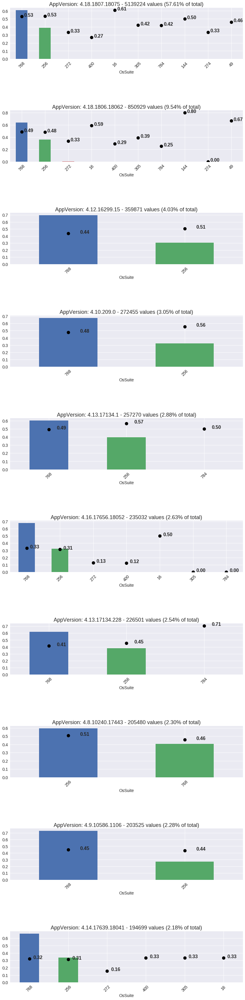

In [52]:
plot_features_interaction_binary(train, 'AppVersion', 'OsSuite', 10, 10, 'HasDetections')

<a id="318"></a>
## AppVersion / IsBeta

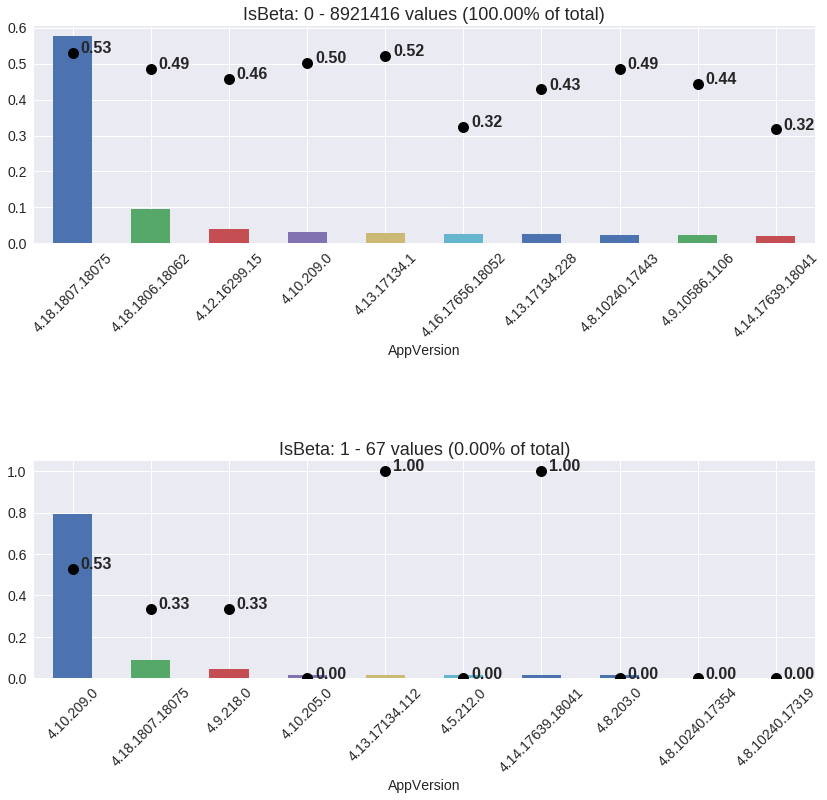

In [53]:
plot_features_interaction_binary(train, 'IsBeta', 'AppVersion', 10, 10, 'HasDetections')

<a id="400"></a>
# EngineVersion
<a id="401"></a>
## EngineVersion / Census_OSInstallTypeName

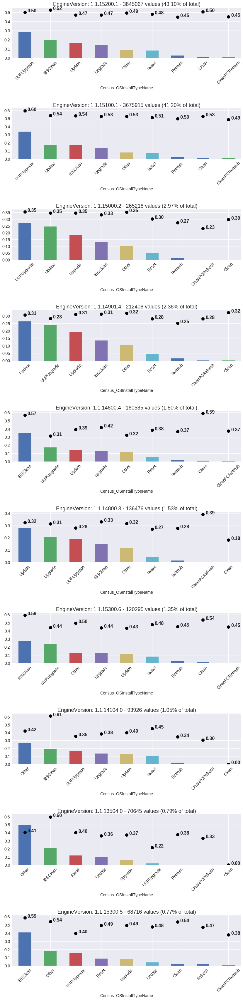

In [54]:
plot_features_interaction_binary(train, 'EngineVersion', 'Census_OSInstallTypeName', 10, 10, 'HasDetections')

<a id="402"></a>
## EngineVersion / Platform

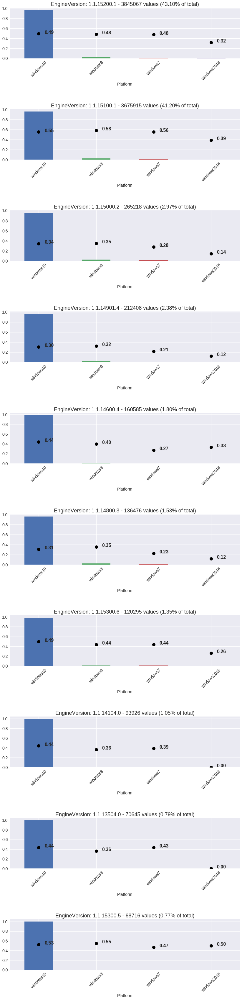

In [55]:
plot_features_interaction_binary(train, 'EngineVersion', 'Platform', 10, 10, 'HasDetections')

<a id="403"></a>
## EngineVersion / OsVer

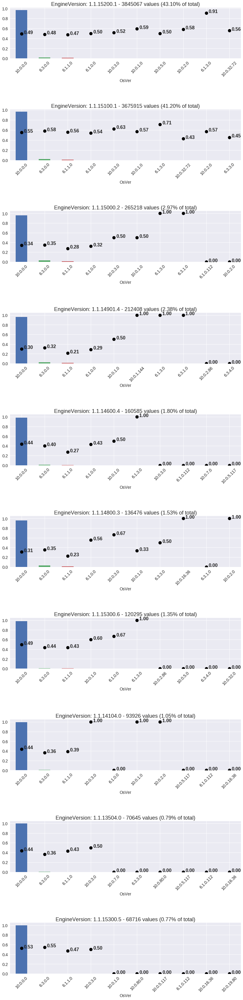

In [56]:
plot_features_interaction_binary(train, 'EngineVersion', 'OsVer', 10, 10, 'HasDetections')

<a id="404"></a>
## EngineVersion / Processor

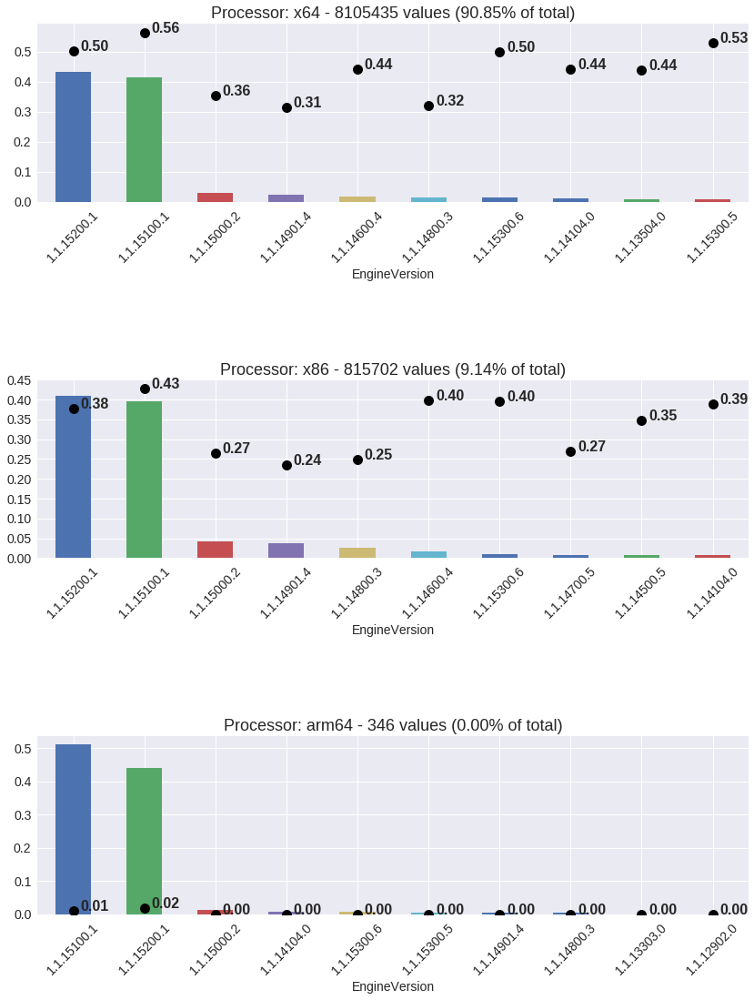

In [57]:
plot_features_interaction_binary(train, 'Processor', 'EngineVersion', 10, 10, 'HasDetections')

<a id="405"></a>
## EngineVersion / Census_OEMModelIdentifier

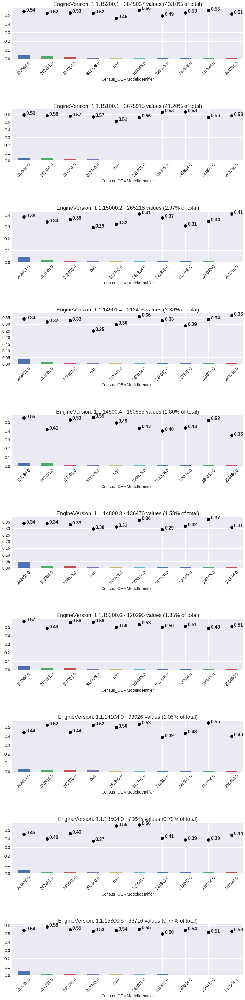

In [58]:
plot_features_interaction_binary(train, 'EngineVersion', 'Census_OEMModelIdentifier', 10, 10, 'HasDetections')

<a id="406"></a>
## EngineVersion / Wdft_IsGamer

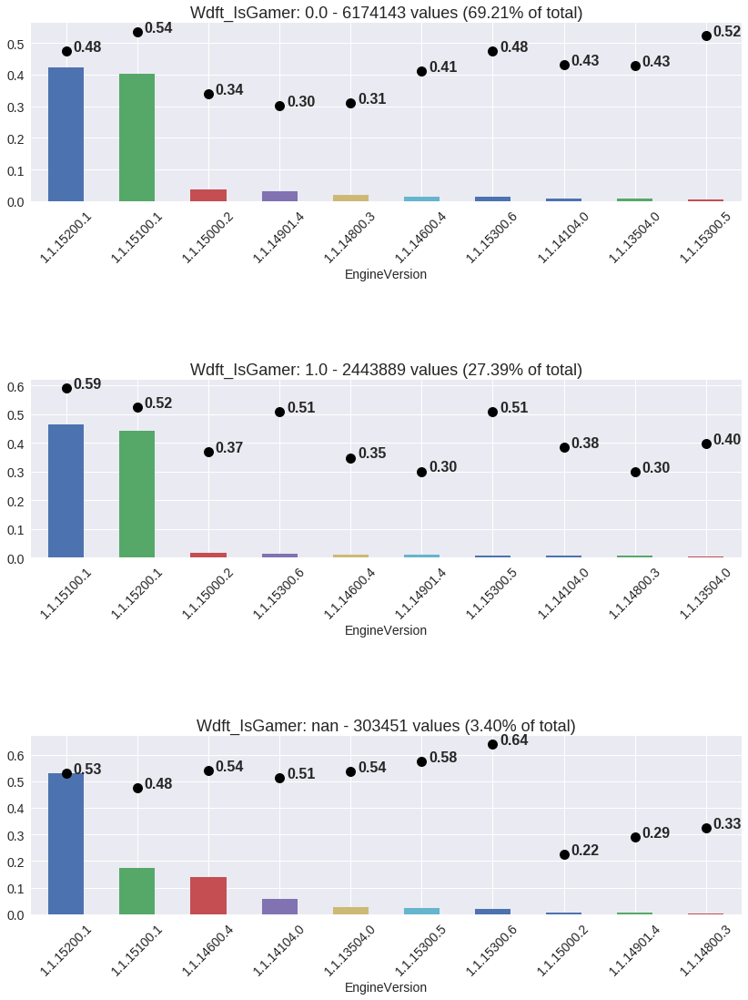

In [59]:
plot_features_interaction_binary(train, 'Wdft_IsGamer', 'EngineVersion', 10, 10, 'HasDetections')

<a id="407"></a>
## EngineVersion / Census_FirmwareVersionIdentifier

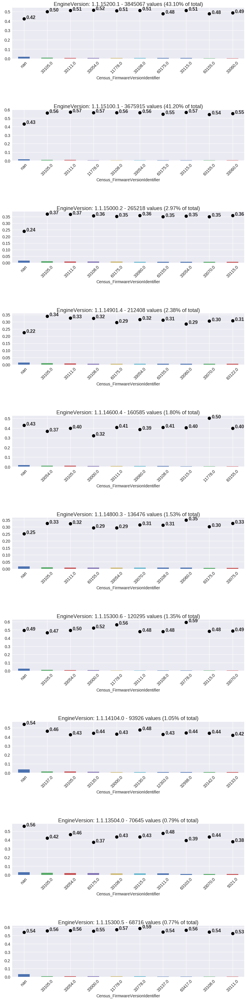

In [60]:
plot_features_interaction_binary(train, 'EngineVersion', 'Census_FirmwareVersionIdentifier', 10, 10, 'HasDetections')

<a id="408"></a>
## EngineVersion / CityIdentifier

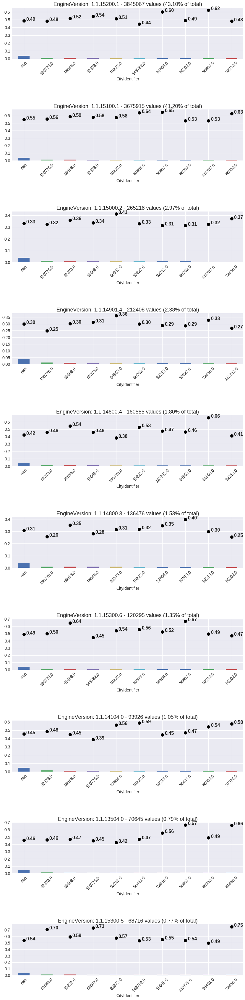

In [61]:
plot_features_interaction_binary(train, 'EngineVersion', 'CityIdentifier', 10, 10, 'HasDetections')

<a id="409"></a>
## EngineVersion / AVProductStatesIdentifier

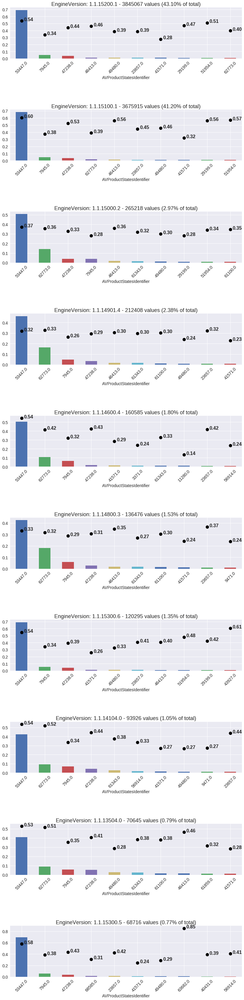

In [62]:
plot_features_interaction_binary(train, 'EngineVersion', 'AVProductStatesIdentifier', 10, 10, 'HasDetections')

<a id="410"></a>
## EngineVersion / Census_ProcessorModelIdentifier

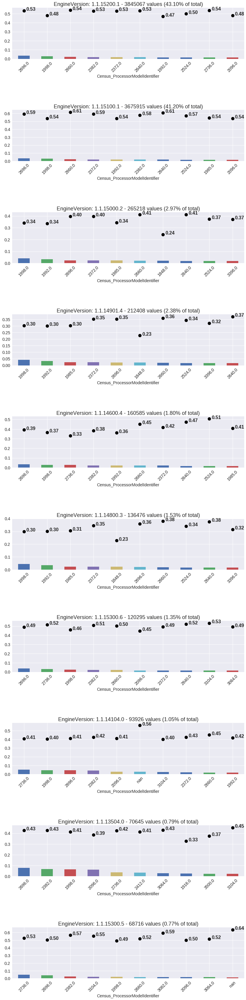

In [63]:
plot_features_interaction_binary(train, 'EngineVersion', 'Census_ProcessorModelIdentifier', 10, 10, 'HasDetections')

<a id="411"></a>
## EngineVersion / AVProductsInstalled

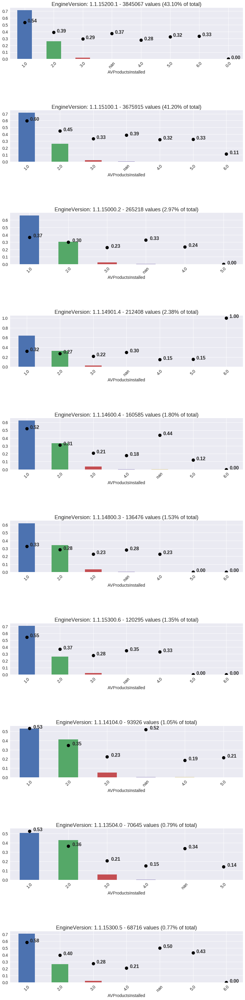

In [64]:
plot_features_interaction_binary(train, 'EngineVersion', 'AVProductsInstalled', 10, 10, 'HasDetections')

<a id="412"></a>
## EngineVersion / LocaleEnglishNameIdentifier

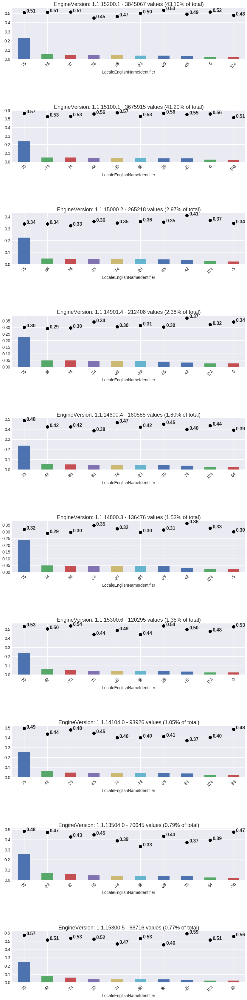

In [65]:
plot_features_interaction_binary(train, 'EngineVersion', 'LocaleEnglishNameIdentifier', 10, 10, 'HasDetections')

<a id="413"></a>
## EngineVersion / GeoNameIdentifier

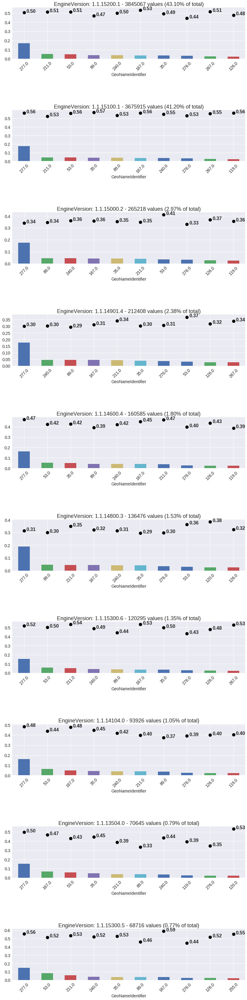

In [66]:
plot_features_interaction_binary(train, 'EngineVersion', 'GeoNameIdentifier', 10, 10, 'HasDetections')

<a id="414"></a>
## EngineVersion / Census_InternalPrimaryDisplayResolutionHorizontal

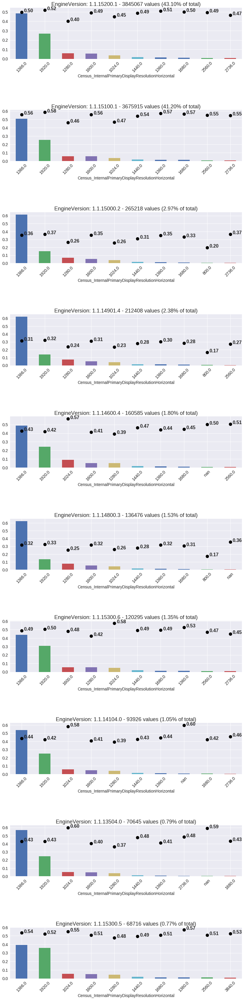

In [67]:
plot_features_interaction_binary(train, 'EngineVersion', 'Census_InternalPrimaryDisplayResolutionHorizontal', 10, 10, 'HasDetections')

<a id="415"></a>
## EngineVersion / Census_TotalPhysicalRAM

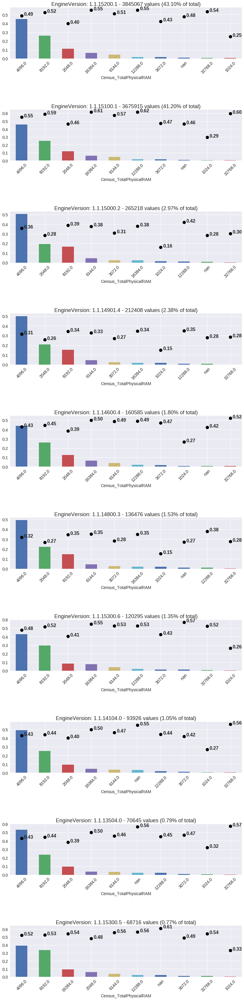

In [68]:
plot_features_interaction_binary(train, 'EngineVersion', 'Census_TotalPhysicalRAM', 10, 10, 'HasDetections')

<a id="416"></a>
## EngineVersion / OsSuite

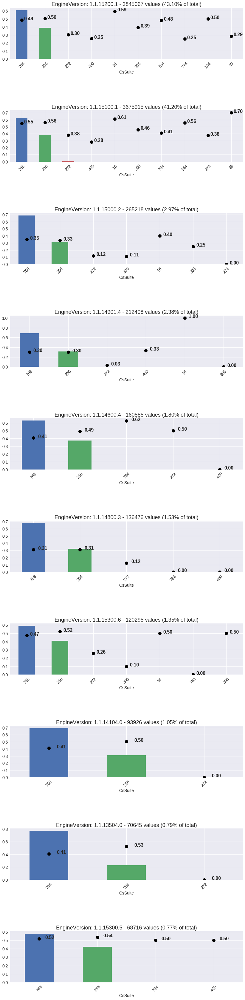

In [69]:
plot_features_interaction_binary(train, 'EngineVersion', 'OsSuite', 10, 10, 'HasDetections')